In [68]:
from PIL import Image
from pylab import *
from numpy import *
import os
from scipy import ndimage


def normalize(points):
    for row in points:
        row /= points[-1]
    return points


def make_homog(points):
    return vstack((points, ones((1, points.shape[1]))))

In [69]:
def H_from_points(fp, tp):
    '''linear DLT'''
    if fp.shape != tp.shape:
        raise RuntimeError('number of points do not match')
    m = mean(fp[:2], axis=1)
    maxstd = max(std(fp[:2], axis=1)) + 1e-9
    C1 = diag([1 / maxstd, 1 / maxstd, 1])
    C1[0][2] = -m[0] / maxstd
    C1[1][2] = -m[1] / maxstd
    fp = dot(C1, fp)
    m = mean(tp[:2], axis=1)
    maxstd = max(std(tp[:2], axis=1)) + 1e-9
    C2 = diag([1 / maxstd, 1 / maxstd, 1])
    C2[0][2] = -m[0] / maxstd
    C2[1][2] = -m[1] / maxstd
    tp = dot(C2, tp)
    nbr_correspondences = fp.shape[1]
    A = zeros((2 * nbr_correspondences, 9))
    for i in range(nbr_correspondences):
        A[2 * i] = [-fp[0][i], -fp[1][i], -1, 0, 0, 0, tp[0][i] * fp[0][i], tp[0][i] * fp[1][i], tp[0][i]]
        A[2 * i + 1] = [0, 0, 0, -fp[0][i], -fp[1][i], -1, tp[1][i] * fp[0][i], tp[1][i] * fp[1][i], tp[1][i]]
    U, S, V = linalg.svd(A)
    H = V[8].reshape((3, 3))
    H = dot(linalg.inv(C2), dot(H, C1))
    return H / H[2, 2]

In [70]:
def Haffine_from_points(fp, tp):
    '''affine transformation'''
    if fp.shape != tp.shape:
        raise RuntimeError('number of points do not match')
    m = mean(fp[:2], axis=1)
    maxstd = max(std(fp[:2], axis=1)) + 1e-9
    C1 = diag([1 / maxstd, 1 / maxstd, 1])
    C1[0][2] = -m[0] / maxstd
    C1[1][2] = -m[1] / maxstd
    fp_cond = dot(C1, fp)
    m = mean(tp[:2], axis=1)
    C2 = C1.copy() 
    C2[0][2] = -m[0] / maxstd
    C2[1][2] = -m[1] / maxstd
    tp_cond = dot(C2, tp)
    A = concatenate((fp_cond[:2], tp_cond[:2]), axis=0)
    U, S, V = linalg.svd(A.T)
    tmp = V[:2].T
    B = tmp[:2]
    C = tmp[2:4]
    tmp2 = concatenate((dot(C, linalg.pinv(B)), zeros((2, 1))), axis=1)
    H = vstack((tmp2, [0, 0, 1]))
    H = dot(linalg.inv(C2), dot(H, C1))
    return H / H[2, 2]

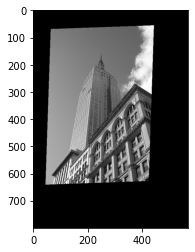

In [71]:
from scipy import ndimage
im = array(Image.open('../pics3/empire.jpg').convert('L'))
H = array([[1.4, 0.05, -100], [0.05, 1.5, -100], [0, 0, 1]])
im2 = ndimage.affine_transform(im, H[:2, :2], (H[0, 2], H[1, 2]))
figure()
gray()
imshow(im2)
show()


In [72]:
def image_in_image(im1, im2, tp):
    m, n = im1.shape[:2]
    fp = array([[0, m, m, 0], [0, 0, n, n], [1, 1, 1, 1]])
    H = Haffine_from_points(tp, fp)
    im1_t = ndimage.affine_transform(im1, H[:2, :2],
                                     (H[0, 2], H[1, 2]), im2.shape[:2])
    alpha = (im1_t > 0)
    return (1 - alpha) * im2 + alpha * im1_t

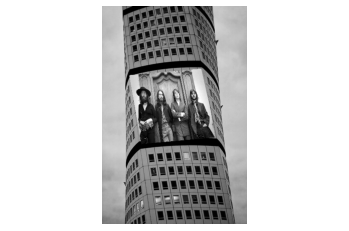

In [81]:
im1 = array(Image.open('../pics3/Beatles.jpg').convert('L'))
im2 = array(Image.open('../pics3/turningtorso1.jpg').convert('L'))
# 选定一些目标点
tp = array([[162,313, 305, 139], [66, 86, 264, 229], [1, 1, 1, 1]])
im3 = image_in_image(im1, im2, tp)
figure()
gray()
imshow(im3)
axis('equal')
axis('off')
show()

In [74]:
def alpha_for_triangle(points, m, n):
    alpha = zeros((m, n))
    for i in range(int(min(points[0])), int(max(points[0]))):
        for j in range(int(min(points[1])), int(max(points[1]))):
            x = linalg.solve(points, [i, j, 1])
            if min(x) > 0:  
                alpha[i, j] = 1
    return alpha

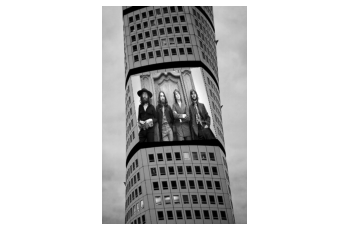

In [82]:
im1 = array(Image.open('../pics3/beatles.jpg').convert('L'))
im2 = array(Image.open('../pics3/turningtorso1.jpg').convert('L'))
m,n = im1.shape[:2]
fp = array([[0,m,m,0],[0,0,n,n],[1,1,1,1]])
tp2 = tp[:,:3]
fp2 = fp[:,:3]
H = Haffine_from_points(tp2,fp2)
im1_t = ndimage.affine_transform(im1,H[:2,:2],
                                 (H[0,2],H[1,2]),im2.shape[:2]) 
alpha = alpha_for_triangle(tp2,im2.shape[0],im2.shape[1])
im3 = (1-alpha)*im2 + alpha*im1_t
tp2 = tp[:,[0,2,3]]
fp2 = fp[:,[0,2,3]]
H = Haffine_from_points(tp2,fp2)
im1_t = ndimage.affine_transform(im1,H[:2,:2],
                                 (H[0,2],H[1,2]),im2.shape[:2])
alpha = alpha_for_triangle(tp2,im2.shape[0],im2.shape[1])
im4 = (1-alpha)*im3 + alpha*im1_t
figure()
gray()
imshow(im4)
axis('equal')
axis('off')
show()

In [15]:
from scipy.spatial import Delaunay
def triangulate_points(x, y):
    tri = Delaunay(np.c_[x, y]).simplices
    return tri

In [19]:
def pw_affine(fromim, toim, fp, tp, tri):
    im = toim.copy()
    is_color = len(fromim.shape) == 3
    im_t = zeros(im.shape, 'uint8')
    for t in tri:
        H = Haffine_from_points(tp[:, t], fp[:, t])
        if is_color:
            for col in range(fromim.shape[2]):
                im_t[:, :, col] = ndimage.affine_transform(
                    fromim[:, :, col], H[:2, :2], (H[0, 2], H[1, 2]), im.shape[:2])
        else:
            im_t = ndimage.affine_transform(
                fromim, H[:2, :2], (H[0, 2], H[1, 2]), im.shape[:2])
        alpha = alpha_for_triangle(tp[:, t], im.shape[0], im.shape[1])
        im[alpha > 0] = im_t[alpha > 0]

    return im


In [20]:
def plot_mesh(x, y, tri):
    for t in tri:
        t_ext = [t[0], t[1], t[2], t[0]]
        plot(x[t_ext], y[t_ext], 'r')

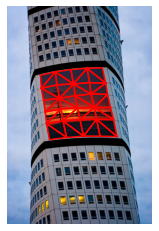

In [21]:
fromim = array(Image.open('../pics3/sunset_tree.jpg'))
x, y = meshgrid(range(5), range(6))
x = (fromim.shape[1] / 4) * x.flatten()
y = (fromim.shape[0] / 5) * y.flatten()
tri = triangulate_points(x, y)
im = array(Image.open('../pics3/turningtorso1.jpg'))
tp = loadtxt('../pics3/turningtorso1_points.txt')  # destination points
fp = vstack((y, x, ones((1, len(x)))))
tp = vstack((tp[:, 1], tp[:, 0], ones((1, len(tp)))))
im = pw_affine(fromim, im, fp, tp, tri)
figure()
imshow(im)
plot_mesh(tp[1], tp[0], tri)
axis('off')
show()

In [22]:
from xml.dom import minidom
def read_points_from_xml(xmlFileName):
    xmldoc = minidom.parse(xmlFileName)
    facelist = xmldoc.getElementsByTagName('face')
    faces = {}
    for xmlFace in facelist:
        fileName = xmlFace.attributes['file'].value
        xf = int(xmlFace.attributes['xf'].value)
        yf = int(xmlFace.attributes['yf'].value)
        xs = int(xmlFace.attributes['xs'].value)
        ys = int(xmlFace.attributes['ys'].value)
        xm = int(xmlFace.attributes['xm'].value)
        ym = int(xmlFace.attributes['ym'].value)
        faces[fileName] = array([xf, yf, xs, ys, xm, ym])
    return faces

In [23]:
def compute_rigid_transform(refpoints, points):
    A = array([[points[0], -points[1], 1, 0],
               [points[1], points[0], 0, 1],
               [points[2], -points[3], 1, 0],
               [points[3], points[2], 0, 1],
               [points[4], -points[5], 1, 0],
               [points[5], points[4], 0, 1]])
    y = array([refpoints[0],
               refpoints[1],
               refpoints[2],
               refpoints[3],
               refpoints[4],
               refpoints[5]])
    a, b, tx, ty = linalg.lstsq(A, y)[0]
    R = array([[a, -b], [b, a]]) 
    return R, tx, ty

In [37]:
from imageio import imwrite
import os


def rigid_alignment(faces, path, plotflag=False):
    refpoints = list(faces.values())[0]
    for face in faces:
        points = faces[face]
        R, tx, ty = compute_rigid_transform(refpoints, points)
        T = array([[R[1][1], R[1][0]], [R[0][1], R[0][0]]])

        im = array(Image.open(os.path.join(path, face)))
        im2 = zeros(im.shape, 'uint8')

        for i in range(len(im.shape)):
            im2[:, :, i] = ndimage.affine_transform(im[:, :, i], linalg.inv(T), offset=[-ty, -tx])
        if plotflag:
            imshow(im2)
            show()

        h, w = im2.shape[:2]
        border = (w + h) / 20

        thePath = os.path.join(path, 'aligned/' + face)
        theImage = im2[int(border):int(h - border), int(border):int(w - border), :]
        imwrite(thePath, theImage)

<ipython-input-23-8d3ac178f5e6>:14: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  a, b, tx, ty = linalg.lstsq(A, y)[0]


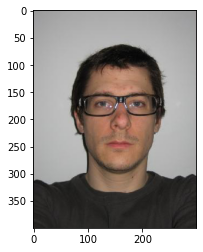

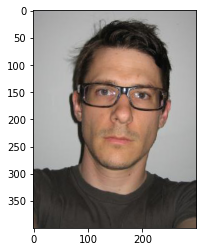

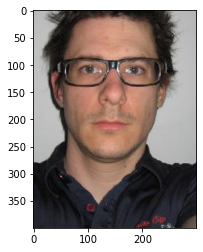

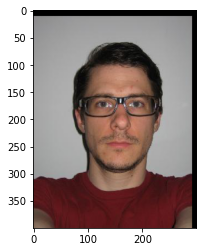

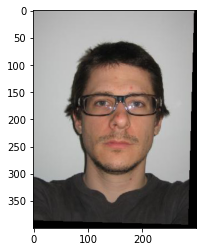

...

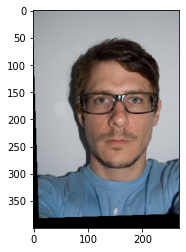

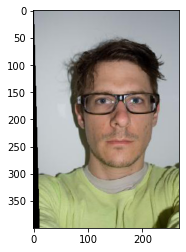

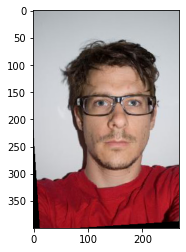

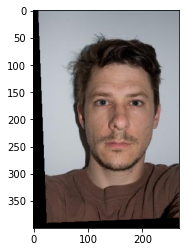

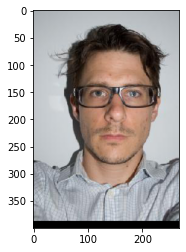

In [38]:
xmlFileName = '../pics3/jkfaces.xml'
points = read_points_from_xml(xmlFileName)
# 注册
rigid_alignment(points, '../pics3/jkfaces', plotflag=True)